In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
from imutils import paths
import cv2

In [4]:
imagesPath= list (paths.list_images('Images_Data'))
imagesPath

['Images_Data\\image1.jpg',
 'Images_Data\\image101.jpg',
 'Images_Data\\image102.jpg',
 'Images_Data\\image103.jpg',
 'Images_Data\\image104.jpg',
 'Images_Data\\image106.jpg',
 'Images_Data\\image109.jpg',
 'Images_Data\\image111.jpg',
 'Images_Data\\image112.jpg',
 'Images_Data\\image114.jpg',
 'Images_Data\\image115.jpg',
 'Images_Data\\image116.jpg',
 'Images_Data\\image117.jpg',
 'Images_Data\\image120.jpg',
 'Images_Data\\image121.jpg',
 'Images_Data\\image122.jpg',
 'Images_Data\\image123.jpg',
 'Images_Data\\image124.jpg',
 'Images_Data\\image14.jpg',
 'Images_Data\\image16.jpg',
 'Images_Data\\image17.jpg',
 'Images_Data\\image18.jpg',
 'Images_Data\\image19.jpg',
 'Images_Data\\image2.jpg',
 'Images_Data\\image20.jpg',
 'Images_Data\\image21.jpg',
 'Images_Data\\image22.jpg',
 'Images_Data\\image23.jpg',
 'Images_Data\\image24.jpg',
 'Images_Data\\image28.jpg',
 'Images_Data\\image29.jpg',
 'Images_Data\\image3.jpg',
 'Images_Data\\image31.jpg',
 'Images_Data\\image34.jpg',


In [5]:
from PIL import Image
import os
import numpy as np

def preprocess_image_pillow(input_folder, output_folder):
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    for img_name in os.listdir(input_folder):
        img_path = os.path.join(input_folder, img_name)
        image = Image.open(img_path).resize((224, 224))  # Resize
        image_array = np.array(image) / 255.0  # Normalize
        image.save(os.path.join(output_folder, img_name))  # Save resized image

input_folder = "Images_Data"
output_folder = "preprocessed_Data"
preprocess_image_pillow(input_folder, output_folder)

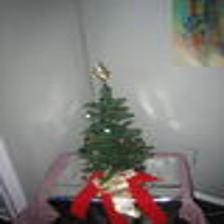

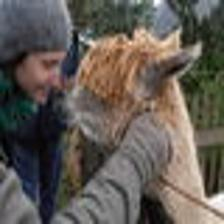

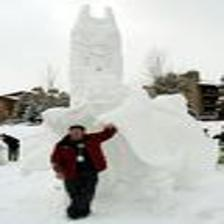

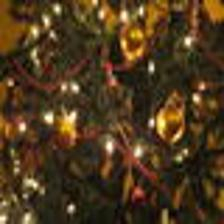

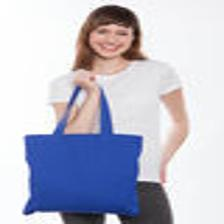

...

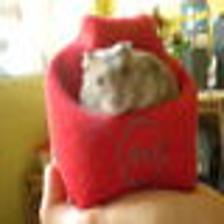

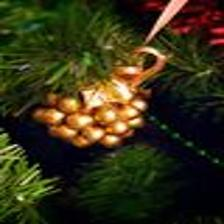

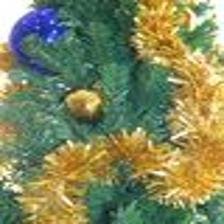

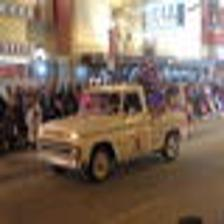

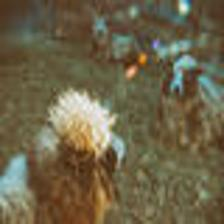

In [6]:
from IPython.display import display
folder_path = 'preprocessed_Data'

# Iterate through all files in the folder
for filename in os.listdir(folder_path):
    # Construct full file path
    file_path = os.path.join(folder_path, filename)
    
    # Check if the file is an image (you can add more extensions if needed)
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        # Open and display the image
        img = Image.open(file_path)
        display(img)

In [7]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

# Create an instance of the ImageDataGenerator with the desired transformations
datagen = ImageDataGenerator(
    rotation_range=40,
    horizontal_flip=True,
    shear_range=0.2,
    zoom_range=0.2,
    width_shift_range=0.2,
    height_shift_range=0.2,
    fill_mode='nearest'
)

# Path to the folder containing images
input_folder = 'preprocessed_Data'
output_folder = 'augmented'

# Create the output folder if it doesn't exist
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# Loop through all images in the input folder
for filename in os.listdir(input_folder):
    if filename.endswith(".jpg") or filename.endswith(".jpeg"):  # Check for image file extensions
        img_path = os.path.join(input_folder, filename)
        img = load_img(img_path)  # Load the image
        x = img_to_array(img)  # Convert the image to an array
        x = np.expand_dims(x, axis=0)  # Add batch dimension

        # Generate augmented images and save them to the output folder
        i = 0
        for batch in datagen.flow(x, batch_size=1, save_to_dir=output_folder, save_prefix='aug', save_format='jpeg'):
            i += 1
            if i >= 5:  # Stop after generating 5 augmented images per input image
                break

print("Augmentation complete for all images in the folder.")

    

Augmentation complete for all images in the folder.


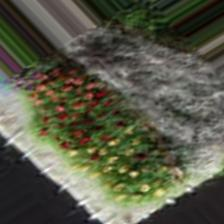

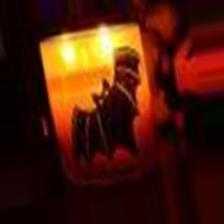

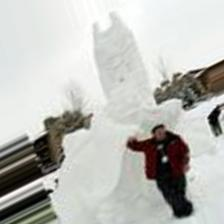

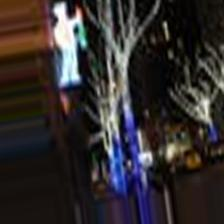

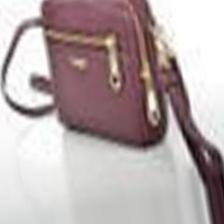

...

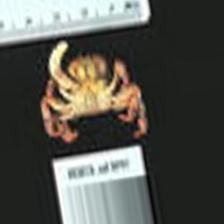

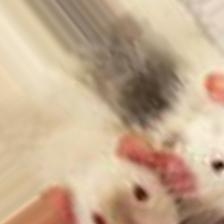

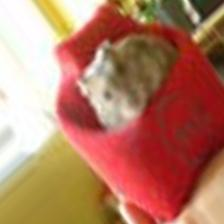

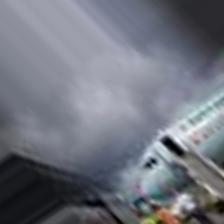

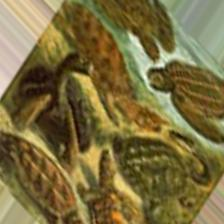

In [8]:
folder_path = 'augmented'

# Iterate through all files in the folder
for filename in os.listdir(folder_path):
    # Construct full file path
    file_path = os.path.join(folder_path, filename)
    
    # Check if the file is an image (you can add more extensions if needed)
    if filename.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
        # Open and display the image
        img = Image.open(file_path)
        display(img)